Data loading and prepocessing 

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

data = pd.read_csv('E:/Schoolwork/RQ/Project/Tritium_data.csv',  encoding = 'latin1')
data.head(3)

,Sample,Station,Easting,Northing,Country/region,UTM Zone,Latitude,Longitude,Aquifer_plot_type,DEM_elevation,...,Barite_SI,Melanterite_SI,Pyrite_SI,FeS(ppt)_SI,Chalcedony_SI,SiO2(a)_SI,Halite_SI,Fluorite_SI,Hydroxyapatite_SI,Kaolinite_SI
0,07-AG-003,W0000370-1,485719.0,4768250.0,Canada/Southern Ontario,17_NAD83,43.066820,-81.175399,OB_drilled,274.6,...,-0.9130,-18.07,31.06,-12.8186,-0.2447,-1.14,-8.37,-1.82,-2.04,3.84
1,07-AG-004,W0000437-1,485282.0,4766213.0,Canada/Southern Ontario,17_NAD83,43.048468,-81.180713,BR_Interface<3m_in_OB,276.5,...,-0.6768,-10.10,-1000.00,-999.9990,-0.1845,-1.07,-7.27,-2.19,-2.51,3.33
2,07-AG-005,W0000053-1,499632.0,4767030.0,Canada/Southern Ontario,17_NAD83,43.055968,-81.004519,BR_deeper_unit,290.2,...,0.0780,-6.12,8.99,0.0552,0.1818,-0.71,-7.36,-1.04,-1.31,3.81


## Study Area
After loading the data we can display it on a map to view where the samples were obtained from in Southern Ontario by maing a sample map/study map area. 

In [4]:
import folium as fl
political_countries_url = (
    "http://geojson.xyz/naturalearth-3.3.0/ne_50m_admin_0_countries.geojson")

m = fl.Map(location=(44, -80), zoom_start=7, tiles="openstreetmap")
m.save("tritium.html")
m



Thd datafile is enormous and is composed of numerous other variables that are not integral to our analysis. In order to get the variables of interest, we can filter the data by columns "Sample, latitude, longitude, Aquifer_type, Well_depth, Temperature_°C, pH, Tritium_Tu,Tritium_error,d18O, D(deuterium)" and drop samples with NaN within the variables of interest across all rows.
We can then perform a quick statistical review using describe() and rounding the figures to 3 decimal places using .round(3).

In [5]:
df = data[['Sample', 'Latitude', 'Longitude', 'Aquifer_type', 'Well_depth', 'Temperature_°C', 'pH', 'Tritium_Tu','Tritium_error','d18O', 'D']]
# Initialize list to store columns with NaN values
columns = []
# Iterate over columns in the DataFrame
for col in df.columns:
    # Check if the column has any NaN values
    if df[col].isnull().any():
        # Add column name to the list
        columns.append(col)
# Print columns with NaN values
#print("Columns with NaN values:", columns)
# Drop rows with NaN values in any column
df.dropna(axis=0, how='any', subset=columns, inplace=True)
# Optional: Reset index if needed
df.reset_index(drop=True, inplace=True)
df.head(5)
df.describe().round(3)

C:\Users\jijo\AppData\Local\Temp\ipykernel_17452\1038023567.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(axis=0, how='any', subset=columns, inplace=True)


,Latitude,Longitude,Well_depth,Temperature_°C,pH,Tritium_Tu,Tritium_error,d18O,D
count,2683.000,2683.000,2683.000,2683.000,2683.000,2683.000,2683.000,2683.000,2683.000
mean,44.247,-78.516,37.476,10.422,7.377,7.069,1.937,-11.419,-76.300
std,1.033,2.505,27.003,1.439,0.550,13.018,1.982,1.431,10.817
min,41.744,-83.077,1.500,5.529,5.710,-13.000,0.000,-19.640,-134.822
25%,43.197,-80.660,18.750,9.500,6.970,-0.800,0.700,-11.983,-80.101
50%,44.336,-79.305,31.000,10.102,7.310,5.200,1.000,-11.260,-74.989
75%,45.319,-76.018,49.400,11.050,7.740,12.900,1.900,-10.573,-70.068
max,45.638,-74.434,199.600,21.400,9.310,200.900,16.500,-5.747,-46.998


The data is now cleaned removing rows with mising values from any of the observed variables. We can then plot and visualize the data to asses the spatial patterns in the Tritium concentrations in southern Ontario dataset. Our cleaned data shows that the mean concentration of tritium is 7.06 Tu

Plotting a scatter of all samples that satisfy the preset conditions within the Southern Ontario region:


c:\Users\jijo\AppData\Local\Programs\Python\Python310\lib\site-packages\matplotlib\collections.py:996: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor
c:\Users\jijo\AppData\Local\Programs\Python\Python310\lib\site-packages\matplotlib\collections.py:996: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


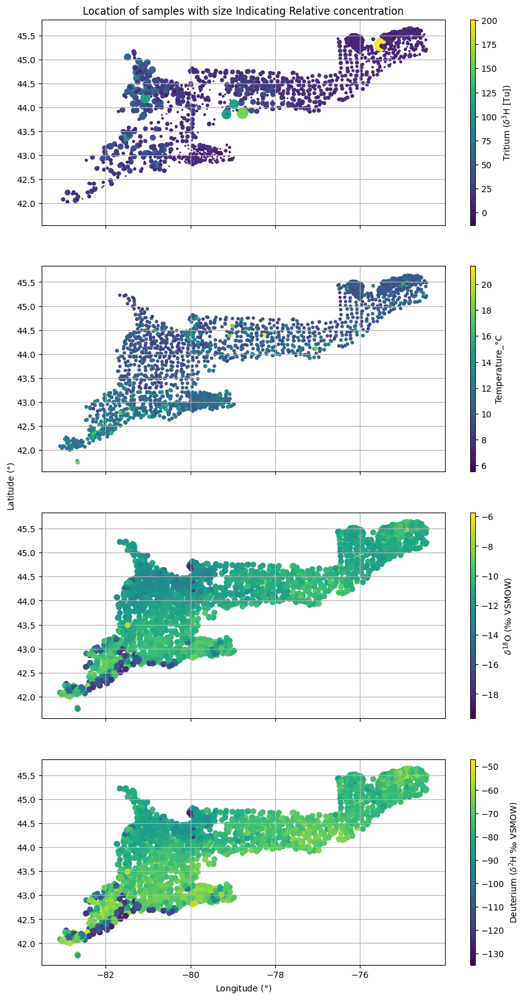

In [6]:
lat =df['Latitude']
lon = df ['Longitude']
tritium =df['Tritium_Tu']
d18O = df['d18O']
temp = df['Temperature_°C']
D = df['D']
fig = plt.figure(figsize=(10, 20))
axes = fig.subplots(nrows=4, ncols=1)
splot = axes[0].scatter(lon,lat, c=tritium, s=tritium)
splot1 = axes[1].scatter(lon,lat, c=temp, s=temp)
splot2 = axes[2].scatter(lon,lat, c=d18O)
splot3 = axes[3].scatter(lon,lat, c=D)
axes[0].set_title('Location of samples with size Indicating Relative concentration')
cbar = fig.colorbar(splot, aspect =40)
cbar1 = fig.colorbar(splot1, aspect =40)
cbar2 = fig.colorbar(splot2, aspect =40)
cbar3 = fig.colorbar(splot3, aspect =40)
cbar.set_label('Tritium ($\delta^{3}$H [Tu])')
cbar1.set_label('Temperature_°C')
cbar2.set_label(r'$\delta^{18}$O (‰ VSMOW)')
cbar3.set_label(r'Deuterium ($\delta^{2}$H ‰ VSMOW)')
plt.xlabel('Longitude ($\xb0$)')
fig.text(0.02, 0.5, 'Latitude ($\xb0$)', va='center', rotation='vertical')  # Common y-label
fig.subplots_adjust(left=0.078)
axes[0].set_xticklabels([])
axes[1].set_xticklabels([])
axes[2].set_xticklabels([])
axes[0].grid()
axes[1].grid()
axes[2].grid()
axes[3].grid()

## Hypothesis 1: High temperatures intensify the rate of tritium decay hence higher tritium concentrations in groundwater with respect to temperature

In [20]:
df

,Sample,Latitude,Longitude,Aquifer_type,Well_depth,Temperature_°C,pH,Tritium_Tu,Tritium_error,d18O,D
0,07-AG-004,43.048468,-81.180713,Overburden,32.6,11.030,7.14,23.0,7.0,-10.292985,-66.089965
1,07-AG-005,43.055968,-81.004519,Bedrock,75.3,11.180,7.60,30.0,7.0,-10.350759,-67.137056
2,07-AG-006,43.114096,-80.843677,Bedrock,33.5,10.670,7.50,-13.0,7.0,-9.631612,-64.807130
3,07-AG-007,43.114115,-80.843726,Overburden,12.2,11.320,7.63,27.0,7.0,-9.753300,-64.987104
4,07-AG-008,43.172732,-80.917532,Bedrock,51.5,9.930,7.28,25.0,7.0,-10.449448,-67.416393
...,...,...,...,...,...,...,...,...,...,...,...
2678,19-AG-995,45.378256,-76.241811,Bedrock,86.3,9.363,6.73,-0.8,0.4,-10.263000,-69.789000
2679,19-AG-996,45.383416,-76.444316,Bedrock,100.6,9.782,7.23,-0.8,0.3,-10.693000,-71.989000
2680,19-AG-997,45.393055,-76.188861,Bedrock,61.0,9.204,8.24,-0.8,0.3,-11.913000,-80.889000
2681,19-AG-998,45.367234,-76.228166,Bedrock,82.0,9.330,7.16,5.1,0.4,-11.983000,-80.589000


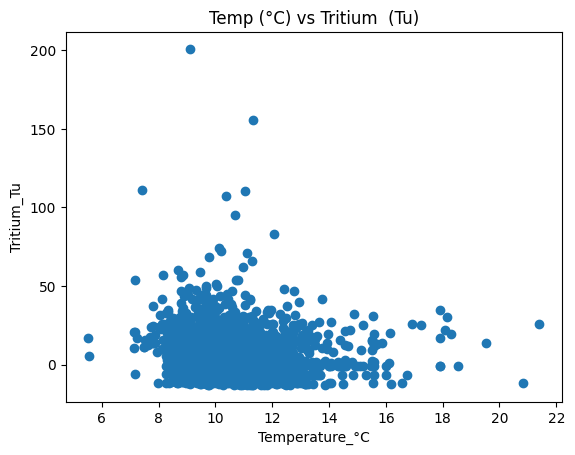

In [26]:
plt.scatter(x=df['Temperature_°C'], y=df['Tritium_Tu'])
plt.ylabel('Tritium_Tu')
plt.xlabel('Temperature_°C')
plt.title('Temp (°C) vs Tritium  (Tu)')
plt.show()

From the scattter plot of Temp vs Tritium concentrations, there is not discernible trend or indication that high tempereatures lead to increased tritium concentrations. it is hard to text this by a scatter plot given that the temperatures recorded are below room temperature (25°C). as such,we can perform a one way anova to tease out the relationship between temperatured and tritium concentrations in the data. 

In [7]:
import scipy
from scipy.stats import f_oneway, ttest_ind
from statsmodels.formula.api import ols
from statsmodels.stats.multicomp import pairwise_tukeyhsd
tritium =df['Tritium_Tu']
d18O = df['d18O']
temp = df['Temperature_°C']
D = df['D']
# Conduct the one-way ANOVA
f_oneway(temp, tritium)

F_onewayResult(statistic=175.85809601406314, pvalue=1.6196996534001232e-39)

The ANOVA (Analysis of Variance) results provided indicate a statistically significant difference among groups, as evidenced by the extremely low p-value (p < 0.05). However, it's important to note that ANOVA alone doesn't provide direct evidence for our specific hypothesis. Instead, it tells us that there is a significant difference in tritium concentrations among different temperature groups. We thus need to perform further analysis, such as post-hoc tests or regression analysis, to examine the relationship between temperature and tritium concentrations more directly. If a significant relationship is found between temperature and tritium concentrations, it would provide support for our hypothesis.  

In [28]:
tukey = pairwise_tukeyhsd(endog=tritium, groups=temp, alpha=0.05)
print("\nPost-hoc test (Tukey's HSD):")
print(tukey)

c:\Users\jijo\AppData\Local\Programs\Python\Python310\lib\site-packages\scipy\integrate\_quadpack_py.py:1233: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  quad_r = quad(f, low, high, args=args, full_output=self.full_output,



Post-hoc test (Tukey's HSD):
  Multiple Comparison of Means - Tukey HSD, FWER=0.05   
group1 group2  meandiff p-adj    lower    upper   reject
--------------------------------------------------------
 5.529   5.56     -11.5    1.0 -107.5712  84.5712  False
 5.529  7.126      -6.5    1.0 -102.5712  89.5712  False
 5.529   7.15       3.6    1.0  -92.4712  99.6712  False
 5.529   7.17      -9.8    1.0  -93.0001  73.4001  False
 5.529   7.18      36.7    1.0  -59.3712 132.7712  False
 5.529   7.24      -0.4    1.0  -96.4712  95.6712  False
 5.529   7.43      93.9 0.0814   -2.1712 189.9712  False
 5.529   7.48      -6.0    1.0 -102.0712  90.0712  False
 5.529    7.5      -5.7    1.0 -101.7712  90.3712  False
 5.529  7.513      -1.5    1.0  -97.5712  94.5712  False
 5.529  7.604      -2.4    1.0  -98.4712  93.6712  False
 5.529   7.64      -4.5    1.0 -100.5712  91.5712  False
 5.529   7.69       0.2    1.0  -95.8712  96.2712  False
 5.529   7.75       6.8    1.0  -89.2712 102.8712  False
 

In [29]:
model = ols('tritium ~ temp', data=df).fit()
print("\nRegression analysis:")
print(model.summary())


Regression analysis:
                            OLS Regression Results                            
Dep. Variable:                tritium   R-squared:                       0.008
Model:                            OLS   Adj. R-squared:                  0.008
Method:                 Least Squares   F-statistic:                     22.84
Date:                Mon, 08 Apr 2024   Prob (F-statistic):           1.85e-06
Time:                        18:33:08   Log-Likelihood:                -10681.
No. Observations:                2683   AIC:                         2.137e+04
Df Residuals:                    2681   BIC:                         2.138e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     15.7350      1.8

## Take-away from Hypothesis 1;

All comparisons of the Tukey HSD test have "reject" as False, and the p-adj values are all 1.0, indicating that none of the mean differences between temperature groups are statistically significant at the chosen significance level (typically 0.05).
The model Summarry from regression analysis also shows that there is positively low/close to negligible correlation between tritium concentrations and temperature in the data analyzed. Therefore, based on these results, we can conclude that there are no significant differences in tritium concentrations among the different temperature groups. Conversely, since there is no significant relationship found, it would suggest that temperature may not be the primary factor influencing tritium concentrations in groundwater in this context.

## Hypothesis 2: the presence of tritium and deuterium in precipitation will result in a positive correlation between 3H (tritium) and 2H (D/deuterium) in the groundwater samples

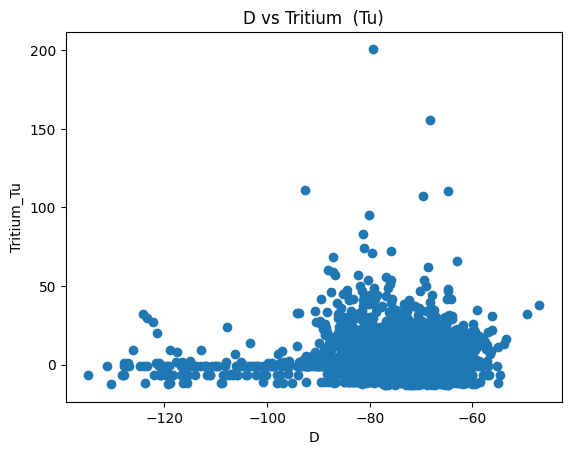

In [30]:
tritium =df['Tritium_Tu']
d18O = df['d18O']
temp = df['Temperature_°C']
D = df['D']
plt.scatter(x=D, y=tritium)
plt.ylabel('Tritium_Tu')
plt.xlabel('D')
plt.title('D vs Tritium  (Tu)')
plt.show()

In [8]:
model = ols('D ~ tritium', data=df).fit()
print("\nRegression analysis:")
print(model.summary())


Regression analysis:
                            OLS Regression Results                            
Dep. Variable:                      D   R-squared:                       0.009
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     24.48
Date:                Tue, 09 Apr 2024   Prob (F-statistic):           7.98e-07
Time:                        10:21:43   Log-Likelihood:                -10183.
No. Observations:                2683   AIC:                         2.037e+04
Df Residuals:                    2681   BIC:                         2.038e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    -76.8583      0.2